In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import numpy as np
import torch
from tqdm.notebook import tqdm, trange

from ddpm import LatentDiffusionModel, CustomDataset, get_ddpm_scheduler_variables, extract

timesteps = 1000
timesteps, betas, alphas, alphas_cumprod, alphas_cumprod_prev, sqrt_recip_alphas, sqrt_alphas_cumprod, sqrt_one_minus_alphas_cumprod, posterior_variance = get_ddpm_scheduler_variables(timesteps=timesteps)

In [2]:

device = torch.device('cuda:7' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
torch.manual_seed(1984)
from utils import get_fixed_query_pc_sdf, sdf2pc
from viz_x import viz_pc, viz_sdf, viz_code, viz_x_img, viz_x, rotation_matrices

Using device: cuda:7


In [3]:

# 初始化模型
latent_dim = 256
hidden_dims = [2048, 2048, 2048, 2048] 
max_freq = 4 
num_bands = 4 
scalar_hidden_dims = [256,256,256,256]
diffusion_model = LatentDiffusionModel(latent_dim, hidden_dims, scalar_hidden_dims, max_freq, num_bands).to(device)

# 12-31
# diffusion_ckpt_path = "/home/ziran/se3/EFEM/lib_shape_prior/dev_ckpt/mugs_ddpm_cos_200k_l1huber_normT_2048_dataNorm/model_epo199999.pth"
diffusion_ckpt_path = "/home/ziran/se3/EFEM/lib_shape_prior/dev_ckpt/mugs_ddpm_cos_400k_l1huber_normT_2048_dataNorm/model_epo399999.pth"
diffusion_ckpt = torch.load(diffusion_ckpt_path, map_location=device)
diffusion_model.load_state_dict(diffusion_ckpt['model'])
diffusion_model = diffusion_model.to(device)
print('Diffusion Model parameters:', sum(p.numel() for p in diffusion_model.parameters()))

from init import get_AEmodel_cfg
from core.models import get_model
category = "mugs"
config_Only_model = get_AEmodel_cfg()
ModelClass = get_model(config_Only_model["model"]["model_name"])
model = ModelClass(config_Only_model)
ckpt_path = f"/home/ziran/se3/EFEM/weights/{category}.pt"
ckpt = torch.load(ckpt_path, map_location=device)
model.network.load_state_dict(ckpt['model_state_dict'])
model.network = model.network.to(device)

codebook_path = f"/home/ziran/se3/EFEM/cache/mugs.npz"
train_ds = CustomDataset(codebook_path, normalization=True)
bs = 3
pred_scale = (torch.ones(bs) + 0.2).to(device)
pred_center = torch.zeros(bs, 1, 3).to(device)
normal_params = train_ds.normal_params


Diffusion Model parameters: 51956544


z_so3 (149, 256, 3)
z_inv (149, 256)
center (149, 1, 3)
scale (149,)
z_so3_proj (149, 256, 3)
z_so3_basis (149, 3, 3)
z_so3_var (149, 3)
bbox (149, 3)
bbox_c (149, 3)
pcl (149, 5000, 3)
cls (149,)
========== Data Normalization BEGIN ==========
z_so3_mean tensor(0.0039)
z_so3_std tensor(0.0359)
z_inv_mean tensor(-0.0006)
z_inv_std tensor(0.0132)
========== Data Normalization FINISHED ==========


In [4]:
import open3d as o3d

def get_rot(pred_x, gt_x, gt_pc=None, normal_params=None, use_pc = False):
    '''
    pred_x: [B, C, 3]
    gt_z: [B, C, 3]
    return:: rot:[B, 3, 3]
    '''
    if not use_pc: # 使用latent code监督
        # 中心化, 去除平移
        pred_x = pred_x[:,:,:3]
        gt_x = gt_x[:,:,:3]
        mean_pred_x_0 = torch.mean(pred_x, dim=1, keepdim=True)
        mean_x_gt = torch.mean(gt_x, dim=1, keepdim=True)
        pred_x_0_centered = pred_x - mean_pred_x_0
        x_gt_centered = gt_x - mean_x_gt

        # 计算协方差矩阵
        H = torch.bmm(pred_x_0_centered.transpose(1, 2), x_gt_centered)

        # 执行奇异值分解
        U, S, V = torch.svd(H)
        rots = []
        # 接下来需要对每个H进行SVD，可能需要循环
        for i in range(pred_x.shape[0]):
            U, _, V = torch.svd(H[i])
            rot = V @ U.T
            # 如果需要保证旋转矩阵是右手坐标系
            if torch.det(rot) < 0:
                V[:, -1] *= -1
                rot = V @ U.T
            rots.append(rot)
        rots = torch.stack(rots)
    else: # 使用 point cloud 监督
        _, pred_sdf = get_fixed_query_pc_sdf(model, pred_x, pred_scale, pred_center, N=60, normal_params=normal_params)
        rots = []
        try:
            verts, _ = sdf2pc(pred_sdf, 60, 0.5)
            
            verts = verts[:, torch.randint(verts.shape[1], (6000,))]
            center_verts = torch.mean(verts, dim=1, keepdim=True)
            verts_centered = (verts - center_verts).to(device)
            
            for i in range(verts_centered.shape[0]):
                pcd1, pcd2 = o3d.geometry.PointCloud(), o3d.geometry.PointCloud()
                pcd1.points = o3d.utility.Vector3dVector(verts_centered[i].cpu().numpy())
                pcd2.points = o3d.utility.Vector3dVector(gt_pc[i].cpu().numpy())

                threshold = 0.5
                trans_init = np.eye(4)
                reg_p2p = o3d.pipelines.registration.registration_icp(
                    pcd1, pcd2, threshold, trans_init, 
                    o3d.pipelines.registration.TransformationEstimationPointToPoint(),
                )
                rotation_matrix = reg_p2p.transformation[:3, :3]
                rots.append(torch.from_numpy(rotation_matrix).float().to(device))
            rots = torch.stack(rots)
        except:
            rots = torch.eye(3).unsqueeze(0).repeat(pred_x.shape[0], 1, 1).to(device)
    return rots



Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [5]:
rot = rotation_matrices([[0,0,1]], [30])[0]
rot = torch.from_numpy(rot).to(device)
rot.shape

x_gt = train_ds[20][0].unsqueeze(0).repeat(bs, 1, 1).to(device=device, dtype=torch.float32)
x_gt[:, :, :3] = x_gt[:, :, :3]  @ rot.T


In [18]:
model.network.requires_grad_(True)

def clamp(x, sigma):
    return torch.clamp(x, -sigma, sigma)

SIGMA = 0.1

loss_l1 = torch.nn.L1Loss()
loss_mse = torch.nn.MSELoss()



def get_recon_score(x, query, query_mask, sdf_gt = None, normal_params=None):
    with torch.enable_grad():
        model.network.zero_grad()
        x = x.detach().requires_grad_(True)
        pred_so3_feat, pred_inv_feat = x[:,:,:3], x[:,:,3]
        if normal_params is not None:
            pred_so3_feat = pred_so3_feat * normal_params["z_so3_std"] + normal_params["z_so3_mean"]
            pred_inv_feat = pred_inv_feat * normal_params["z_inv_std"] + normal_params["z_inv_mean"]
        embedding = {
            "z_so3": pred_so3_feat, # [B, 256, 3]
            "z_inv": pred_inv_feat, # [B, 256]
            "s": pred_scale, # [B]
            "t": pred_center, # [B, 1, 3]
        }
        sdf_hat = model.network.decode(query, None, embedding, return_sdf=True)
        if sdf_gt is None:
            sdf_gt = torch.zeros_like(query, device=device, dtype=torch.float32)
        # loss = loss_l1(sdf_hat, sdf_gt)
        loss = clamp(sdf_hat - sdf_gt, SIGMA).abs().mean()
        loss_item = loss.item()
        grad_x = torch.autograd.grad(loss, x)[0].detach().requires_grad_(False)
        return grad_x, loss_item

def get_pc_sdf(mode, bs, uniform_N, surface_N, normal_N, normal_eps):
    # 获取gt_pc:
    _, decode_sdf = get_fixed_query_pc_sdf(model, x_gt, pred_scale, pred_center, 60, 0.5, normal_params=train_ds.normal_params)
    gt_pc, _ = sdf2pc(decode_sdf, 60, 0.5)
    gt_pc_num = 3000
    gt_pc_sample_idx = torch.randint(gt_pc.shape[1], (gt_pc_num,))
    gt_pc = gt_pc[:, gt_pc_sample_idx, :].to(device)
    
    pcs = []
    sdfs = []
    if uniform_N >0:
        fixed_pc, fixed_sdf = get_fixed_query_pc_sdf(model, x_gt, pred_scale, pred_center, uniform_N, normal_params=train_ds.normal_params)
        pcs.append(fixed_pc)
        sdfs.append(fixed_sdf)
        print("fixed_pc:", fixed_pc.shape,"fixed_sdf:", fixed_sdf.shape)

    if surface_N > 0:
        decode_pc, decode_sdf = get_fixed_query_pc_sdf(model, x_gt, pred_scale, pred_center, 60, 0.5, normal_params=train_ds.normal_params)
        verts, _ = sdf2pc(decode_sdf, 60, 0.5)
        indices = torch.randint(verts.shape[1], (surface_N,))
        surface_pc = verts[:,indices,:].to(device)
        # surface_pc = torch.tensor(verts[indices]).unsqueeze(0).repeat(bs,1,1).to(device) # [B, verts_N, 3]
        # surface_pc = torch.stack([surface_pc[b, indices[b]] for b in range(bs)])
        surface_sdf = torch.zeros_like(surface_pc[:, :, 0]).to(device)
        pcs.append(surface_pc)
        sdfs.append(surface_sdf)
        print("surface_pc:", surface_pc.shape, "surface_sdf:", surface_sdf.shape)
    if normal_N > 0:
        decode_pc, decode_sdf = get_fixed_query_pc_sdf(model, x_gt, pred_scale, pred_center, 60, 0.5, normal_params=train_ds.normal_params)
        verts, normals = sdf2pc(decode_sdf, 60, 0.5)
        out_verts = verts + normals * normal_eps
        in_verts = verts - normals * normal_eps

        # out_normal_pc = torch.tensor(out_verts).unsqueeze(0).repeat(bs,1,1).to(device) # [B, verts_N, 3]
        out_normal_pc = out_verts.to(device)
        indices = torch.randint(out_normal_pc.shape[1], (out_normal_pc.shape[0], normal_N//2))
        out_normal_pc = torch.stack([out_normal_pc[b, indices[b]] for b in range(bs)])
        out_normal_sdf = torch.zeros_like(out_normal_pc[:, :, 0]).to(device) + normal_eps

        # in_normal_pc = torch.tensor(in_verts).unsqueeze(0).repeat(bs,1,1).to(device) # [B, verts_N, 3]
        in_normal_pc = in_verts.to(device)
        indices = torch.randint(in_normal_pc.shape[1], (in_normal_pc.shape[0], normal_N//2))
        in_normal_pc = torch.stack([in_normal_pc[b, indices[b]] for b in range(bs)])
        in_normal_sdf = torch.zeros_like(in_normal_pc[:, :, 0]).to(device) - normal_eps

        normal_pc = torch.cat([out_normal_pc, in_normal_pc], dim=1)
        normal_sdf = torch.cat([out_normal_sdf, in_normal_sdf], dim=1)

        # normal_pc = out_normal_pc
        # normal_sdf = out_normal_sdf

        pcs.append(normal_pc)
        sdfs.append(normal_sdf)
        print("normal_pc:", normal_pc.shape, "normal_sdf:", normal_sdf.shape)
        
    hybrid_pc = torch.cat(pcs, dim=1)
    hybrid_sdf = torch.cat(sdfs, dim=1)
    print("hybrid_pc:", hybrid_pc.shape, "hybrid_sdf:", hybrid_sdf.shape)
    return hybrid_pc, hybrid_sdf, gt_pc

In [14]:
hybrid_pc, hybrid_sdf, gt_pc = get_pc_sdf("hybrid", bs, 6, 0, 0, 0.01)
# viz_pc(gt_pc[0])
# gt_pc.shape
viz_pc(hybrid_pc[0])

fixed_pc: torch.Size([3, 216, 3]) fixed_sdf: torch.Size([3, 216])
hybrid_pc: torch.Size([3, 216, 3]) hybrid_sdf: torch.Size([3, 216])


In [8]:
# # MASK 
# plane_normal = torch.tensor([0,0,1], dtype=torch.float32).to(device)


# mask = (hybrid_pc @ plane_normal) >= 0
# hybrid_pc = hybrid_pc[mask].reshape(bs, -1, 3)
# hybrid_sdf = hybrid_sdf[mask].reshape(bs, -1)

# mask = (gt_pc @ plane_normal) >= 0
# gt_pc = gt_pc[mask].reshape(-1, 3)


In [9]:
print("x max", hybrid_pc[0][:, 0].max())
print("x min", hybrid_pc[0][:, 0].min())
print("y max", hybrid_pc[0][:, 1].max())
print("y min", hybrid_pc[0][:, 1].min())
print("z max", hybrid_pc[0][:, 2].max())
print("z min", hybrid_pc[0][:, 2].min())

x max tensor(0.5000, device='cuda:7')
x min tensor(-0.5000, device='cuda:7')
y max tensor(0.5000, device='cuda:7')
y min tensor(-0.5000, device='cuda:7')
z max tensor(0.5000, device='cuda:7')
z min tensor(-0.5000, device='cuda:7')


In [23]:
# gamma = 1e4
gamma_start = 1e4
gamma_end = 1e4
gamma_exp = 1
gamma = torch.linspace(gamma_end**gamma_exp, gamma_start**gamma_exp, timesteps) ** (1/gamma_exp)
gamma = gamma.to(device)

score_x_list = []
score_recon_list = []
score_list = []
recon_loss_list = []

pred_x_0_list = []
delta_x_t_list = []

rot_list = []

# reverse diffusion
@torch.no_grad()
def p_sample(model, x, t, t_index):
    betas_t = extract(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = extract(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = extract(sqrt_recip_alphas, t, x.shape)

    # Note: \grad_{x_t} \log p(x_t|x_0) = - (\epsilon) / (\sqrt{1 - \alpha^{hat}_t})
    #                                   = - model(x, t) / sqrt_one_minus_alphas_cumprod_t
    model_out = model(x, t, timesteps)
    score_x = model_out / sqrt_one_minus_alphas_cumprod_t

    sqrt_alphas_cumprod_t = extract(sqrt_alphas_cumprod, t, x.shape)
    pred_x_0 = (x - sqrt_one_minus_alphas_cumprod_t * model_out) / sqrt_alphas_cumprod_t

    # ======== ROT =========
    # pred_rots = get_rot(pred_x_0[:,:,:3], x_gt[:,:,:3], gt_pc=gt_pc, use_pc=True)
    if t[0] % 100 == 0:
        pred_rots = get_rot(pred_x_0, x_gt, gt_pc=gt_pc, use_pc=False)
        # pred_rots = get_rot(pred_x_0, x_gt, gt_pc=gt_pc, use_pc=True)
    else:
        pred_rots = torch.eye(3).unsqueeze(0).repeat(pred_x_0.shape[0], 1, 1).to(device)

    
    pred_x_0[:,:,:3] = pred_x_0[:,:,:3] @ pred_rots.transpose(1,2)
    # ----------------------
    score_x[:,:,:3] = score_x[:,:,:3] @ pred_rots.transpose(1,2)
    x[:,:,:3] = x[:,:,:3] @ pred_rots.transpose(1,2)
    # ----------------------
    rotation_magnitude = torch.norm(pred_rots - torch.eye(3).to(device), dim=(1,2)).mean()
    rot_list.append(rotation_magnitude.item())
    # ======== ROT =========



    # score_recon, recon_loss = torch.zeros_like(score_x), 0
    score_recon, recon_loss = get_recon_score(pred_x_0, hybrid_pc, None, sdf_gt=hybrid_sdf, normal_params=train_ds.normal_params)

    score = score_x + gamma[t[0]].item()  * score_recon 
    # score = score_x + gamma * score_recon

    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * score
    )
    
    pred_x_0_list.append(pred_x_0.cpu())
    score_x_list.append(score_x.abs().mean().item())
    score_recon_list.append(score_recon.abs().mean().item())
    score_list.append(score.abs().mean().item())
    recon_loss_list.append(recon_loss)
    delta_x_t_list.append((pred_x_0-model_mean).abs().mean().item())
    
    if t_index == 0:
        return model_mean
    else:
        posterior_variance_t = extract(posterior_variance, t, x.shape)
        noise = torch.randn_like(x)
        # noise = gamma * recon_loss
        # Algorithm 2 line 4:
        return model_mean + torch.sqrt(posterior_variance_t) * noise

# Algorithm 2:
@torch.no_grad()
def p_sample_loop(model, shape, return_traj=False):
    device = next(model.parameters()).device

    b = shape[0]
    # start from pure noise (for each example in the batch)
    x_t = torch.randn(shape, device=device)
    traj = []

    for i in tqdm(reversed(range(0, timesteps)), desc='sampling loop time step', total=timesteps):
        x_t_minus1 = p_sample(model, x_t, torch.full((b,), i, device=device, dtype=torch.long), i)
        x_t = x_t_minus1
        traj.append(x_t.cpu())
    if return_traj:
        return torch.stack(traj, dim=1)
    else:
        return x_t

torch.manual_seed(2)
# x_0 = p_sample_loop(model=diffusion_model, shape=(bs, 256, 4), return_traj=False)
traj = p_sample_loop(model=diffusion_model, shape=(bs, 256, 4), return_traj=True)



begin = 0
end = 100
torch.tensor(score_x_list[begin:end]).mean(), torch.tensor(score_recon_list[begin:end]).mean()

sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

/tmp/ipykernel_2002641/2119950926.py:56: UserWarning:

The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at /opt/conda/conda-bld/pytorch_1670525541702/work/torch/csrc/utils/tensor_numpy.cpp:199.)



(tensor(0.8154), tensor(4.5970e-05))

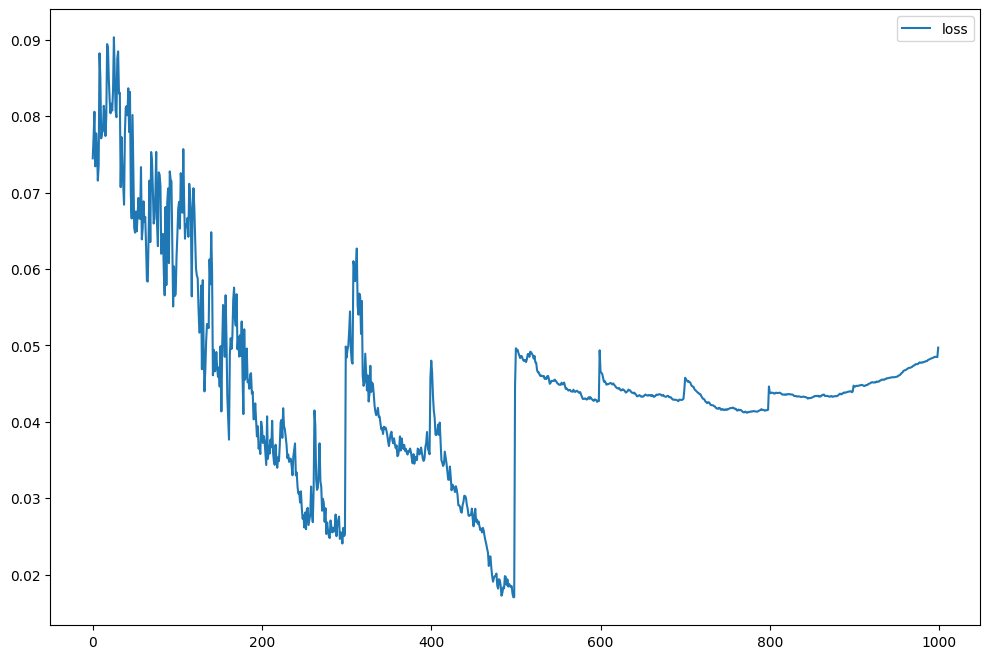

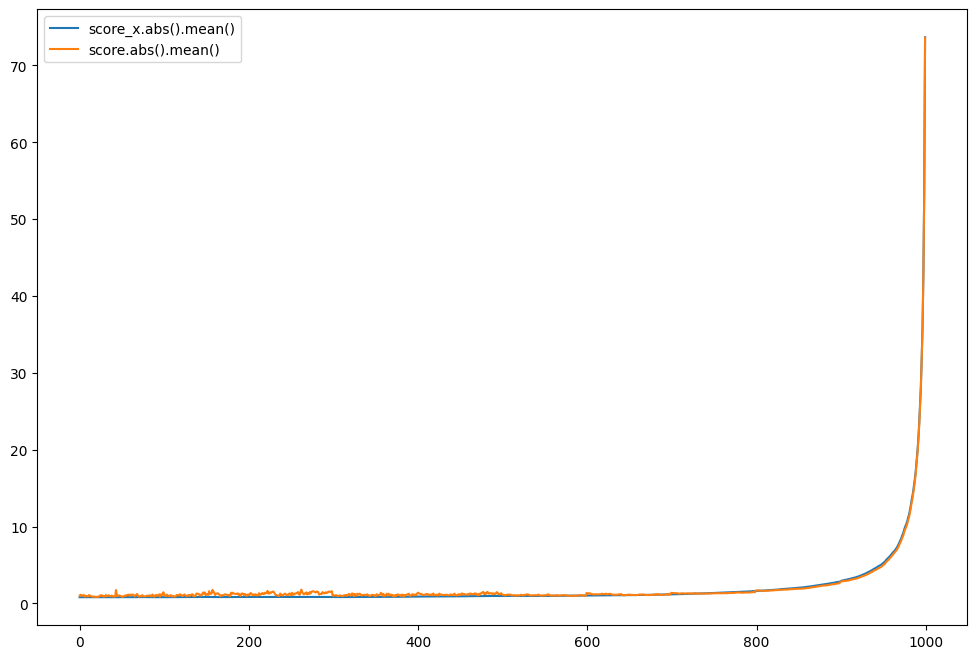

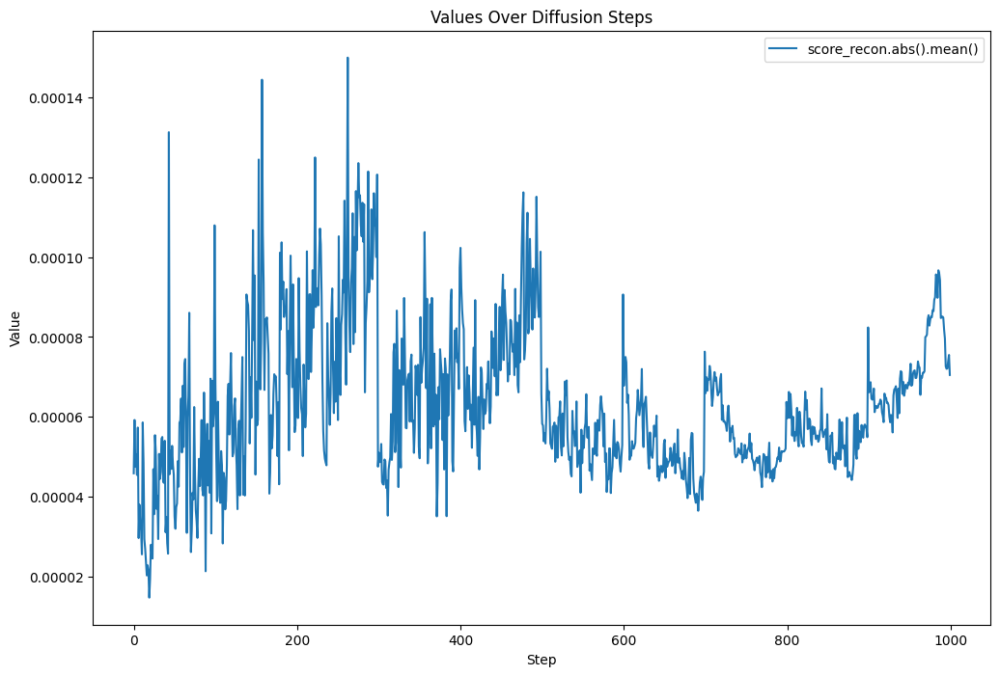

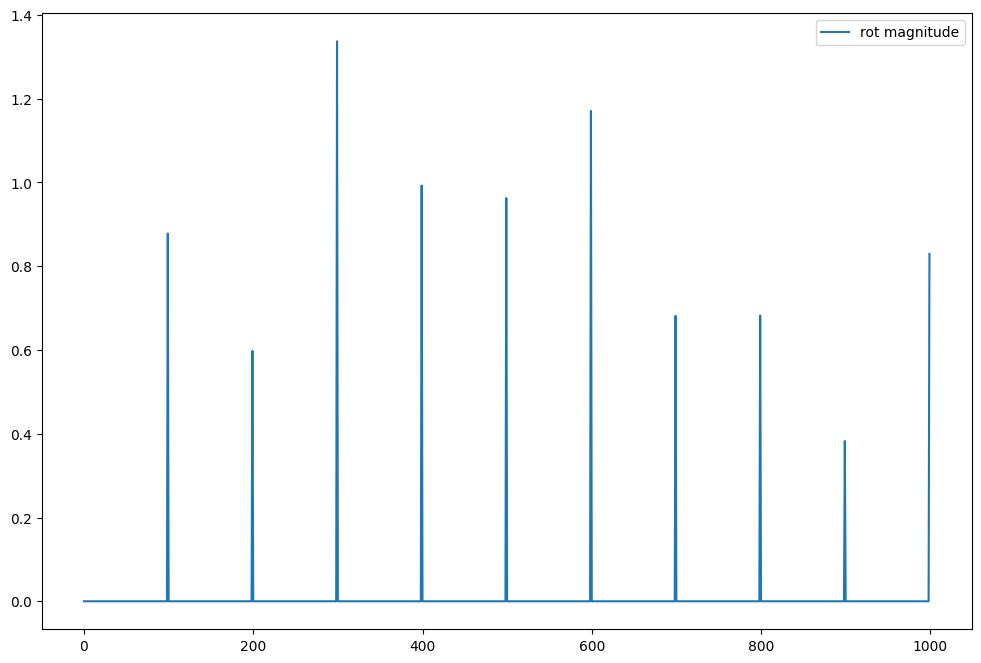

In [25]:
import numpy as np
import matplotlib.pyplot as plt

def remove_outliers(data, threshold_factor=1.5):
    # q3, q1 = np.percentile(data, [75, 25])
    # iqr = q3 - q1
    # upper_bound = q3 + threshold_factor * iqr
    # return [x for x in data if x <= upper_bound]
    return data


plt.figure(figsize=(12, 8))
plt.plot(remove_outliers(recon_loss_list), label='loss')
plt.legend()
plt.show()

plt.figure(figsize=(12, 8))
plt.plot(remove_outliers(score_x_list), label='score_x.abs().mean()')
plt.plot(remove_outliers(score_list), label='score.abs().mean()')
plt.legend()

plt.figure(figsize=(12, 8))

plt.plot(remove_outliers(score_recon_list), label='score_recon.abs().mean()')
plt.xlabel('Step')
plt.ylabel('Value')
plt.title('Values Over Diffusion Steps')
plt.legend()
# plt.ylim(0, 10)
plt.show()

# plt.figure(figsize=(12, 8))
# plt.plot(remove_outliers(delta_x_t_list), label='loss')
# plt.legend()


plt.figure(figsize=(12, 8))
plt.plot(remove_outliers(rot_list), label='rot magnitude')
plt.legend()
plt.show()

use normal params: {'z_so3_mean': tensor(0.0039), 'z_so3_std': tensor(0.0359), 'z_inv_mean': tensor(-0.0006), 'z_inv_std': tensor(0.0132)}
shape:  torch.Size([20, 256, 3]) torch.Size([20, 256]) torch.Size([20]) torch.Size([20, 1, 3])
rows: 4 cols: 5


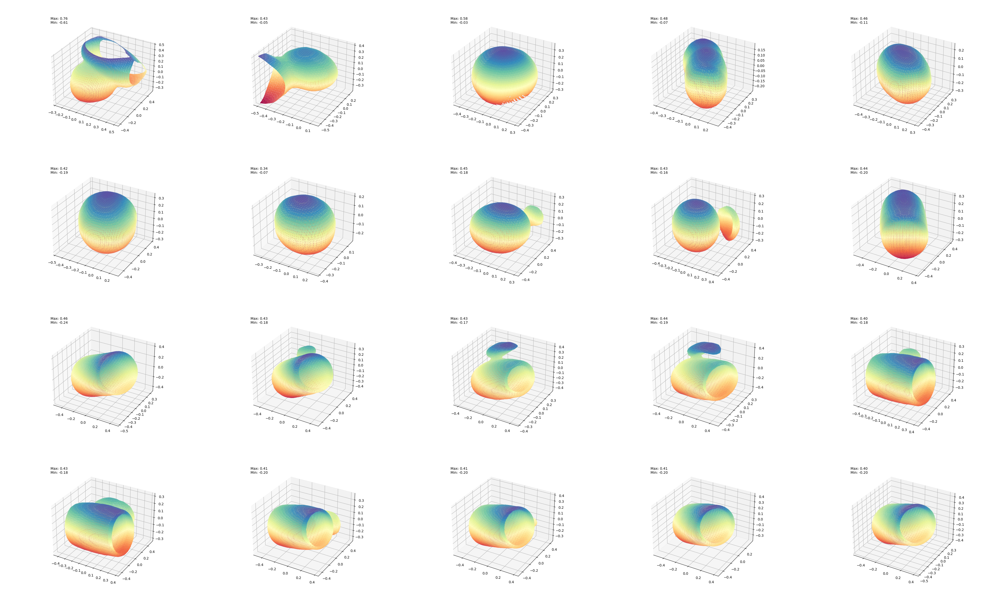

In [26]:
img_list, img = viz_x_img(torch.stack(pred_x_0_list, dim=1)[2,0:1001:50,], model, device, normal_params)
display(img)

In [27]:
# viz_pc(query[0][:])
x_0 = traj[:,-1,:,:]
viz_x(x_0, model, device, normal_params=train_ds.normal_params, gt_pc=gt_pc[0])
# viz_x(x_0, model, device, normal_params=train_ds.normal_params, )


use normal params: {'z_so3_mean': tensor(0.0039), 'z_so3_std': tensor(0.0359), 'z_inv_mean': tensor(-0.0006), 'z_inv_std': tensor(0.0132)}
shape:  torch.Size([3, 256, 3]) torch.Size([3, 256]) torch.Size([3]) torch.Size([3, 1, 3])


Max: 0.36058202 Min -0.02239976
x max: 0.40399915 x min: -0.35715103
y max: 0.42869043 y min: -0.49855328
z max: 0.351184 z min: -0.43283898


Max: 0.45398048 Min -0.20192474
x max: 0.43266517 x min: -0.3661508
y max: 0.4142056 y min: -0.44192657
z max: 0.3647449 z min: -0.41262946


Max: 0.46471015 Min -0.20744114
x max: 0.42418206 x min: -0.48977825
y max: 0.40495563 y min: -0.49558356
z max: 0.43955457 z min: -0.48072797
